This script is an experiment in analyzing multi-hazard impacts on the power grid

The goal of this script is to identify a candidate set of wildfire + space weather events

It uses the following approach:
- Read in set of wildfire events from XXXX
- Get time period, get spatial extent (GIS) -> visualize it
- Highest level: get space weather indices
    - more granular is to get magnetometers and GNSS data (GIMs, likely) in the area of the fire 
- Get HIFLD grid affected based on the wildfire
- (optional) get observed power grid disturbances that overlap in space and time
- Record the candidate event for forensic analysis (social media, interviews, grey literature exploration)

#### Dependencies and Custom Functions

In [15]:
import numpy as np
import pandas as pd
import os, sys

import geopandas as gpd

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.dates import DateFormatter

import contextily as ctx


import supermag_api




In [ ]:
def get_sm_one_minute(start,end):

    '''

    
    Dependencies
        supermag-api downloadable from https://supermag.jhuapl.edu/mag/?fidelity=low&start=2001-01-01T00%3A00%3A00.000Z&interval=1%3A00%3A00&tab=api
            --> one should move this to the working directory and rename to supermag_api
        datetime
            
    Notes
        it appears this will only work for a few-day request; for longer periods, need to download the data directly
            
    '''


#     import supermag_api
#     import datetime

    start_datetime = pd.to_datetime(start)
    end_datetime = pd.to_datetime(end)
    
    # get the number of days between start and end
    num_days = (end_datetime - start_datetime).days
    print('the number of days that will be requested is {}'.format(num_days))
    input('Press Enter if you are sure you want to ping the SuperMAG API for this...')
    
    # get correct format for 'start date'
    date_obj_start = datetime.strptime(start, '%Y-%m-%d %H:%M:%S')
    formatted_start = date_obj_start.strftime('%Y-%m-%dT%H:%M')

    (status,df_smidxs) = supermag_api.SuperMAGGetIndices('rymc1012',formatted_start,86400*num_days,'SME, SMU, SML, SMR')

    datetimes_sm = [pd.to_datetime(t, unit='s') for t in df_smidxs['tval']]

    df_smidxs['datetimes'] = datetimes_sm
    df_smidxs = df_smidxs.set_index(['datetimes'])
    df_smidxs.index = pd.to_datetime(df_smidxs.index)
    
    return df_smidxs





#### Wildfire database

Some things I'm learning about wildfire data
- MODIS might be best available given coverage
- There is a NASA digital twin project https://ideas-digitaltwin.jpl.nasa.gov/airquality/, but it is focused on air quality and thus the atmospheric emissions associated with wildfire, whereas for this work I need the wildfires themselves (note their emissions which then mix with the atmosphere and its dynamics)
- ...


In [8]:
# NASA FIRMS data https://firms.modaps.eosdis.nasa.gov


# National Interagency Fire Center https://www.nifc.gov/
file_path_nifc_wildfire = "/Users/ryanmc/Documents/Conferences/Jack_Eddy_Symposium_2022/dev/wildfire_data/WFIGS_Incident_Locations_6818922478522849878.geojson"
file_path_modis_wildfire = "/Users/ryanmc/Documents/Conferences/Jack_Eddy_Symposium_2022/dev/wildfire_data/DL_FIRE_M-C61_530609/fire_archive_M-C61_530609.shp"

# gdf_nifc_wildfire = gpd.read_file(file_path_nifc_wildfire)
gdf_modis_wildfire = gpd.read_file(file_path_modis_wildfire)




In [10]:
# Explore the first few rows
print(gdf_modis_wildfire.head())

# Check the geometry type (e.g., Point, Polygon, LineString)
print(gdf_modis_wildfire.geom_type.unique())

# Get summary of the attributes
print(gdf_modis_wildfire.info())

# # Plot the shapefile (quick visualization)
# gdf.plot()


   LATITUDE  LONGITUDE  BRIGHTNESS  SCAN  TRACK    ACQ_DATE ACQ_TIME  \
0   26.5690   -81.0586       328.5   2.5    1.5  2023-01-01     1819   
1   26.5640   -81.0828       327.4   2.5    1.5  2023-01-01     1819   
2   26.5611   -81.0496       318.6   2.5    1.5  2023-01-01     1819   
3   26.5507   -81.0793       310.5   2.5    1.5  2023-01-01     1819   
4   26.5557   -81.0552       310.1   2.5    1.5  2023-01-01     1819   

  SATELLITE INSTRUMENT  CONFIDENCE VERSION  BRIGHT_T31   FRP DAYNIGHT  TYPE  \
0      Aqua      MODIS          83   61.03       294.2  81.2        D     0   
1      Aqua      MODIS          82   61.03       294.4  76.7        D     0   
2      Aqua      MODIS          73   61.03       294.6  41.4        D     0   
3      Aqua      MODIS          57   61.03       293.5  17.9        D     0   
4      Aqua      MODIS          54   61.03       294.9  17.2        D     0   

                     geometry  
0  POINT (-81.05860 26.56900)  
1  POINT (-81.08280 26.56400

In [12]:
gdf_modis_wildfire

,LATITUDE,LONGITUDE,BRIGHTNESS,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,INSTRUMENT,CONFIDENCE,VERSION,BRIGHT_T31,FRP,DAYNIGHT,TYPE,geometry
0,26.5690,-81.0586,328.5,2.5,1.5,2023-01-01,1819,Aqua,MODIS,83,61.03,294.2,81.2,D,0,POINT (-81.05860 26.56900)
1,26.5640,-81.0828,327.4,2.5,1.5,2023-01-01,1819,Aqua,MODIS,82,61.03,294.4,76.7,D,0,POINT (-81.08280 26.56400)
2,26.5611,-81.0496,318.6,2.5,1.5,2023-01-01,1819,Aqua,MODIS,73,61.03,294.6,41.4,D,0,POINT (-81.04960 26.56110)
3,26.5507,-81.0793,310.5,2.5,1.5,2023-01-01,1819,Aqua,MODIS,57,61.03,293.5,17.9,D,0,POINT (-81.07930 26.55070)
4,26.5557,-81.0552,310.1,2.5,1.5,2023-01-01,1819,Aqua,MODIS,54,61.03,294.9,17.2,D,0,POINT (-81.05520 26.55570)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93995,35.5124,-81.4234,306.1,1.2,1.1,2023-12-31,1913,Aqua,MODIS,63,61.03,284.9,10.4,D,0,POINT (-81.42340 35.51240)
93996,35.5149,-81.4294,304.1,1.2,1.1,2023-12-31,1913,Aqua,MODIS,58,61.03,285.0,9.5,D,0,POINT (-81.42940 35.51490)
93997,36.5638,-85.6422,311.3,1.0,1.0,2023-12-31,1913,Aqua,MODIS,71,61.03,283.7,12.6,D,0,POINT (-85.64220 36.56380)
93998,30.7894,-100.6265,305.4,2.2,1.4,2023-12-31,2050,Aqua,MODIS,56,61.03,294.7,13.1,D,0,POINT (-100.62650 30.78940)


/Users/ryanmc/opt/anaconda3/envs/spwxr_network/lib/python3.9/site-packages/contextily/tile.py:645: UserWarning: The inferred zoom level of 32 is not valid for the current tile provider (valid zooms: 0 - 19).
  warnings.warn(msg)


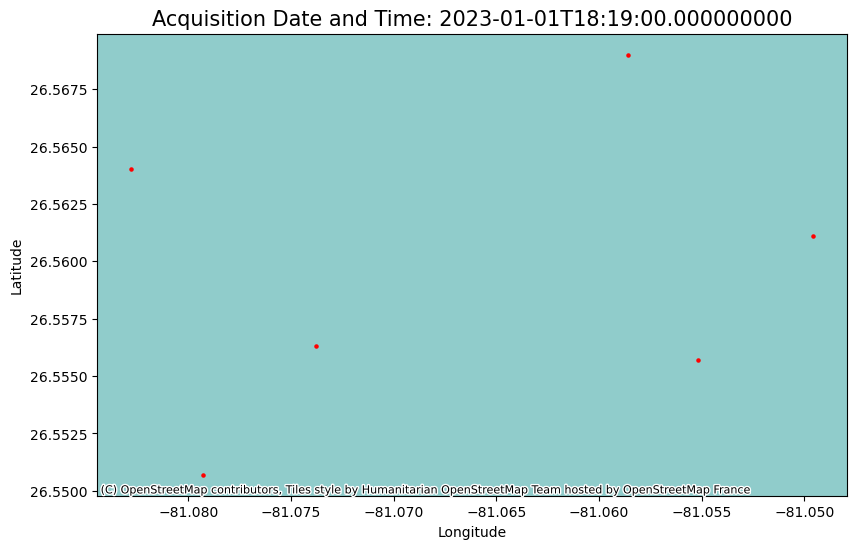

KeyboardInterrupt: Interrupted by user

In [22]:
if 'ACQ_DATE' in gdf_modis_wildfire.columns and 'ACQ_TIME' in gdf_modis_wildfire.columns:
    gdf_modis_wildfire['datetime'] = (
        gdf_modis_wildfire['ACQ_DATE'].astype(str) + ' ' + gdf_modis_wildfire['ACQ_TIME'].astype(str)
    )
    gdf_modis_wildfire['datetime'] = pd.to_datetime(gdf_modis_wildfire['datetime'])
else:
    raise ValueError("Expected 'ACQ_DATE' and 'ACQ_TIME' columns.")

# Group by unique acquisition dates and times
unique_datetimes = gdf_modis_wildfire['datetime'].unique()

# Loop over each unique datetime and plot the corresponding points
for dt in unique_datetimes:
    subset = gdf_modis_wildfire[gdf_modis_wildfire['datetime'] == dt]

    # Plot the points for this specific acquisition time
    fig, ax = plt.subplots(figsize=(10, 6))
    subset.plot(ax=ax, color='red', marker='o', markersize=5)

    # Customize plot title and labels
    ax.set_title(f"Acquisition Date and Time: {dt}", fontsize=15)
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")
    
#     ax = subset.to_crs(epsg=3857).plot(ax=ax, color='red', marker='o', markersize=5)
    ctx.add_basemap(ax)
    
    # Display the plot
    plt.show()
    
    input('push any button...')


In [26]:
subset

,LATITUDE,LONGITUDE,BRIGHTNESS,SCAN,TRACK,ACQ_DATE,ACQ_TIME,SATELLITE,INSTRUMENT,CONFIDENCE,VERSION,BRIGHT_T31,FRP,DAYNIGHT,TYPE,geometry,datetime
0,26.5690,-81.0586,328.5,2.5,1.5,2023-01-01,1819,Aqua,MODIS,83,61.03,294.2,81.2,D,0,POINT (-81.05860 26.56900),2023-01-01 18:19:00
1,26.5640,-81.0828,327.4,2.5,1.5,2023-01-01,1819,Aqua,MODIS,82,61.03,294.4,76.7,D,0,POINT (-81.08280 26.56400),2023-01-01 18:19:00
2,26.5611,-81.0496,318.6,2.5,1.5,2023-01-01,1819,Aqua,MODIS,73,61.03,294.6,41.4,D,0,POINT (-81.04960 26.56110),2023-01-01 18:19:00
3,26.5507,-81.0793,310.5,2.5,1.5,2023-01-01,1819,Aqua,MODIS,57,61.03,293.5,17.9,D,0,POINT (-81.07930 26.55070),2023-01-01 18:19:00
4,26.5557,-81.0552,310.1,2.5,1.5,2023-01-01,1819,Aqua,MODIS,54,61.03,294.9,17.2,D,0,POINT (-81.05520 26.55570),2023-01-01 18:19:00
5,26.5563,-81.0738,341.6,2.5,1.5,2023-01-01,1819,Aqua,MODIS,91,61.03,294.1,154.3,D,0,POINT (-81.07380 26.55630),2023-01-01 18:19:00


In [25]:
import folium
from folium.plugins import TimestampedGeoJson

# Convert GeoDataFrame to GeoJSON-like dictionary with timestamp for Folium
features = []
for _, row in gdf_modis_wildfire.iterrows():
    feature = {
        'type': 'Feature',
        'geometry': row['geometry'].__geo_interface__,
        'properties': {
            'time': row['datetime'].isoformat(),  # Use ISO format for timestamps
            'popup': f"Acquired: {row['datetime']}"
        }
    }
    features.append(feature)

# Create the Timestamped GeoJSON layer
timestamped_geojson = TimestampedGeoJson(
    {'type': 'FeatureCollection', 'features': features},
    period='PT1H',  # Period for animation: 1 hour
    add_last_point=False,
    auto_play=False,
    loop=True,
    max_speed=1,
    loop_button=True,
    date_options='YYYY-MM-DD HH:mm:ss',
    time_slider_drag_update=True
)

# Initialize a Folium map centered on the dataset's centroid
m = folium.Map(
    location=[gdf_modis_wildfire.geometry.y.mean(), gdf_modis_wildfire.geometry.x.mean()],
    zoom_start=6, tiles='CartoDB positron'
)

# Add the timestamped layer to the map
timestamped_geojson.add_to(m)

# Save the map as an HTML file and display it
m.save('interactive_map.html')

# If running in Jupyter, display the map directly
m


#### HIFLD data
uses HIFLD data: https://hifld-geoplatform.hub.arcgis.com/datasets/geoplatform::transmission-lines

In [ ]:
file_path_powergrid = "/Users/ryanmc/Documents/Conferences/Jack_Eddy_Symposium_2022/dev/physical_grid_data/U.S._Electric_Power_Transmission_Lines.geojson"
gdf_powergrid = gpd.read_file(file_path_powergrid)



#### Candidate search